# Actividad 2
# Usos reales de filtros espaciales y morfológicos

## Autores:
- José Antonio Betances Vargas
- Jacobo Farray Rodríguez
- Pedro Alejandro González Morales
- Jean Michael Urday García

Ausente: José Enrique Cabrera Pérez

## Fecha de reuniones:

| Fecha | J. A. Betance Vargas | J. Farray Rodríguez | P. A. González Morales | J. M. Urday Garcia | J. E. Cabrera Pérez |
| -- | -- | -- | -- | -- | -- |
| 19.05.2021 | Ok | Ok | Ok | Ok | No |
| 22.05.2021 |Ok | Ok | Ok | Ok | No |
| 24.05.2021 |Ok | Ok | Ok | Ok | No |
| 26.05.2021 |Ok | Ok | Ok | Ok | No |

## Descripción del problema

El propósito de este notebook es aplicar operaciones morfológicos y/o filtros espaciales sobre imágenes de documentos escaneados o fotografiados con la intención de eliminar anomalías, sombras en este caso, y mejorar su legibilidad.

## Solución propuesta

Se utiliza como referencia el código de Stackoverflow (2017).

La solución propuesta es:
   1. Separa la imagen en sus canales RGB.
   2. Aplicar una operación morfológica de dilatación sobre cada canal para dilatar el fondo y así remover el texto. 
   3. Aplicar un filtro espacial de mediana al resultado para difuminar el efecto de la dilatación y elimiar ruido impulsivo, generando de esta manera una imagen de fondo.
   4. Restar a cada canal su imagen de fondo y normalizar el resultado.
   5. Reconstruir la imagen a color RGB a partir de las tres imagenes normalizadas.
   
A continución se muestra el código e indican los pasos relevantes.

In [11]:
import cv2
import numpy as np
from IPython.display import display
from PIL import Image

In [12]:
def main(imagePath):
    img = cv2.imread(imagePath)
    
    rgb_planes = cv2.split(img)  # 1. Separar

    kernel = np.ones((5,5))
    result_norm_planes = []
    for plane in rgb_planes:
        dilated_img = cv2.dilate(plane, kernel)  # 2. Operación morfológica
        bg_img = cv2.medianBlur(dilated_img, 71) # 3. Filtro espacial
        # 4. Resta y normalización
        diff_img = 255 - cv2.absdiff(plane, bg_img)
        norm_img = cv2.normalize(diff_img,None, alpha=0, beta=255, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_8UC1)
        
        result_norm_planes.append(norm_img)

    result_norm = cv2.merge(result_norm_planes) # 5. Reconstrucción
    imagesFinal = cv2.cvtColor(np.hstack([img,result_norm]) ,cv2.COLOR_BGR2RGB)
    
    display(Image.fromarray(imagesFinal))
    


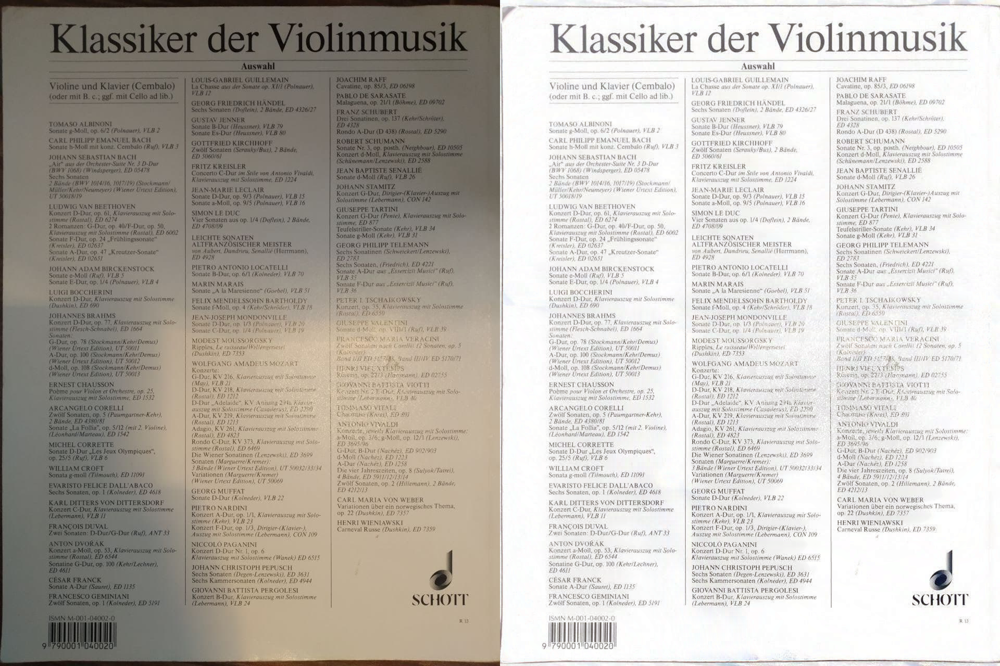

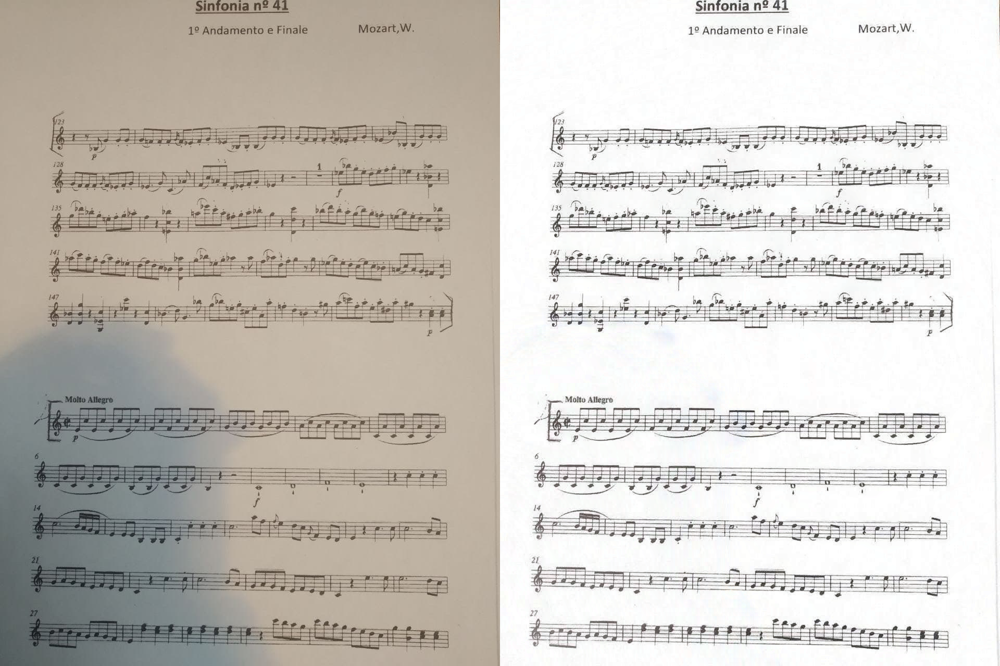

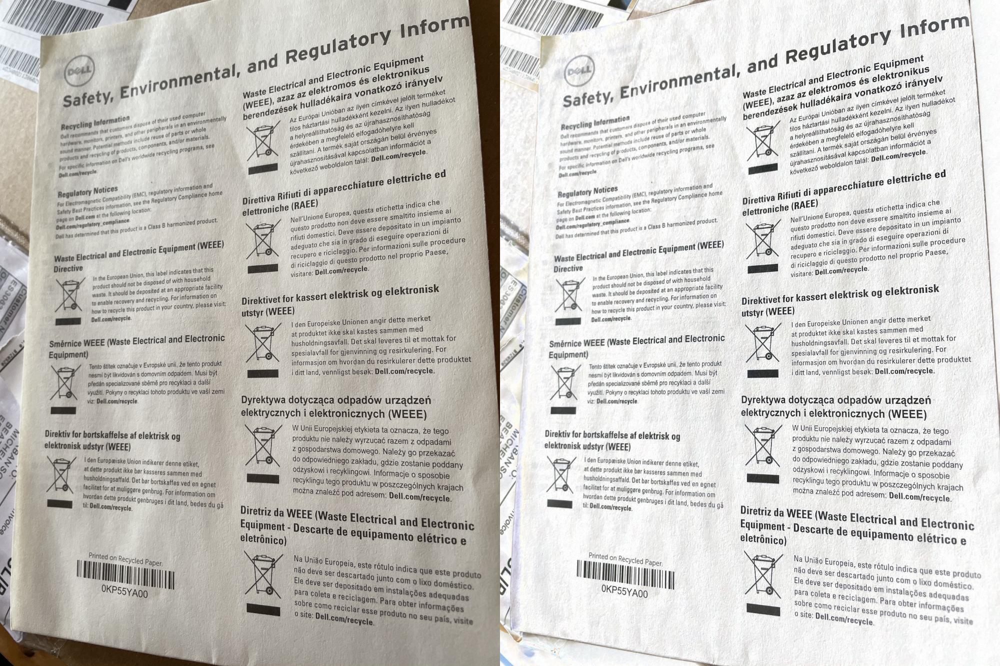

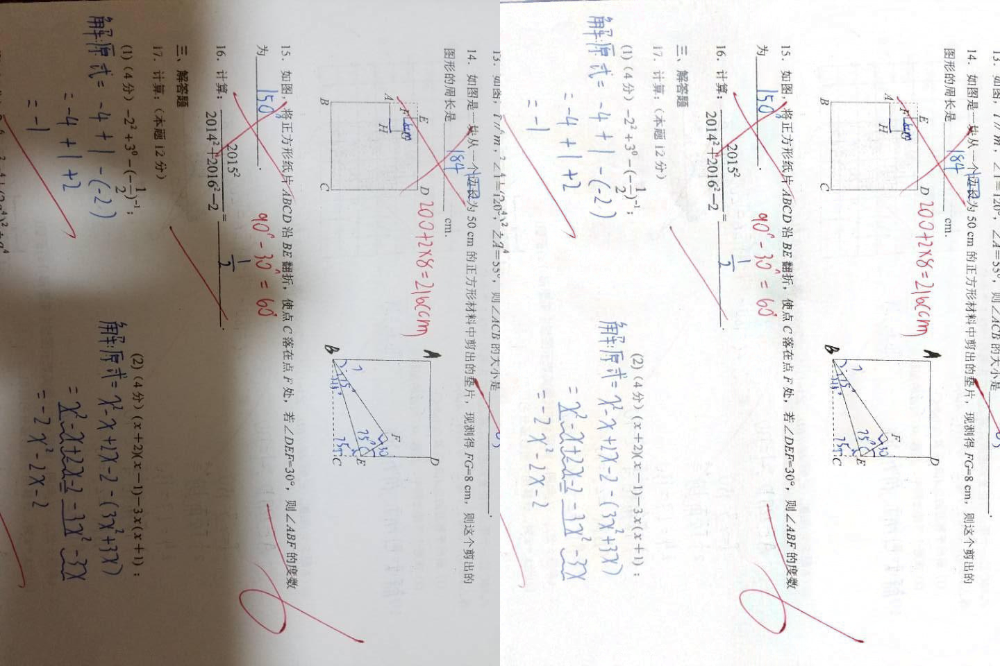

In [13]:
main('Foto3.jpg')
main('Foto4.jpg')
main('Foto5.jpg')
main('Foto7.jpg') # Stackoverflow (2017)

## Conclusiones

Se ha trabajado con una operación morfológica y un filtro espacial para corregir imagenes de documentos. 

Para mejorar la calidad de los resultados, se han optimizado los parámetros libres de la dilatación y del filtro de mediana usando varias imágenes de prueba.

## Limitaciones del algoritmo

La solución propuesta se puede mejorar en aspectos como:
- Segmentación de la imagen para separar texto y dibujos del fondo.
- Mejorar el color

Como ejemplos ofrecemos estas 2 imagenes. 

En esta primera foto, el problema está en que la sombra tiene internamente gradientes y el algoritmo no corrige bien los bordes.

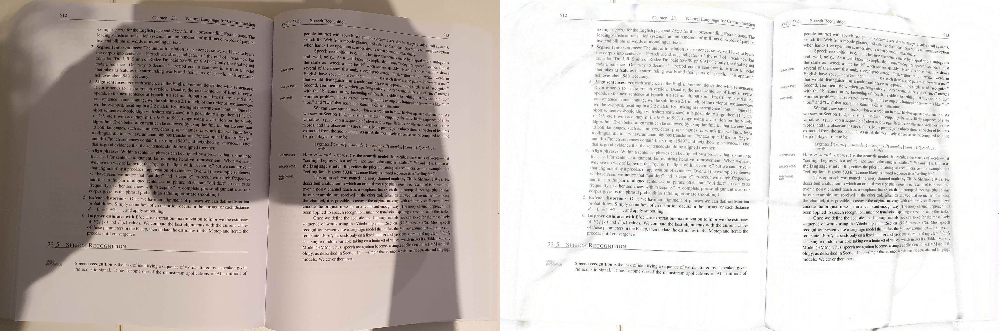

In [14]:
main('Foto1.jpg')

En esta segunda imagen, el algoritmo presenta problemas con manchas complejas.

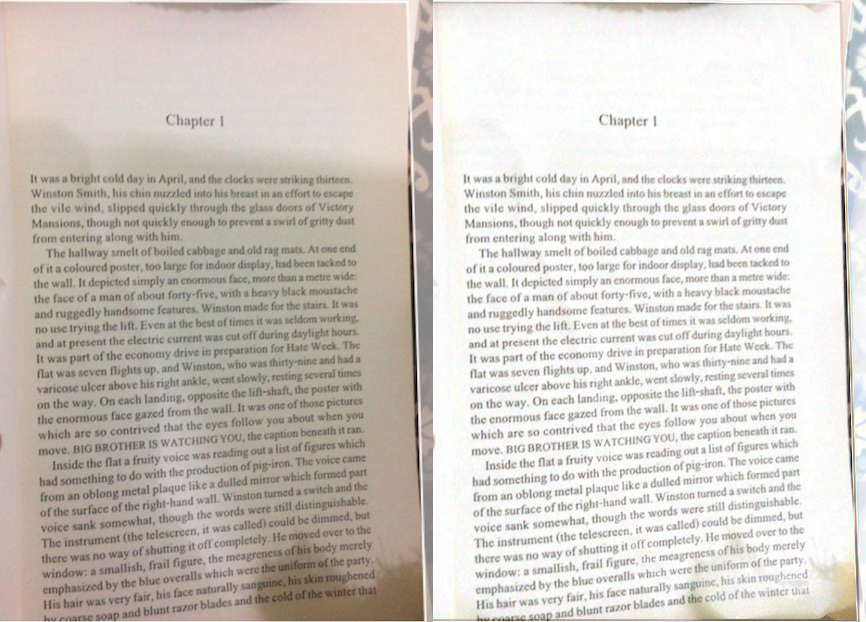

In [15]:
main('Foto6.jpg')

Como posibles soluciones se plantea hacer una detección de bordes y/o una segmentación previa de la imagen para detectar estas estructuras.

## Referencias

Stackoverflow (2017). How to remove shadow from scanned images using OpenCV? En *Stackoverflow* Recuperado el 18 de mayo de 2021 en https://stackoverflow.com/questions/44752240/how-to-remove-shadow-from-scanned-images-using-opencv